In [23]:
import cv2
from matplotlib import pyplot as plt

In [24]:
# Load images
image1 = cv2.imread('./panaroma_generation/1.jpg')
image2 = cv2.imread('./panaroma_generation/2.jpg')
image3 = cv2.imread('./panaroma_generation/3.jpg')
image4 = cv2.imread('./panaroma_generation/4.jpg')
image5 = cv2.imread('./panaroma_generation/5.jpg')
image6 = cv2.imread('./panaroma_generation/6.jpg')
image7 = cv2.imread('./panaroma_generation/7.jpg')
image8 = cv2.imread('./panaroma_generation/8.jpg')

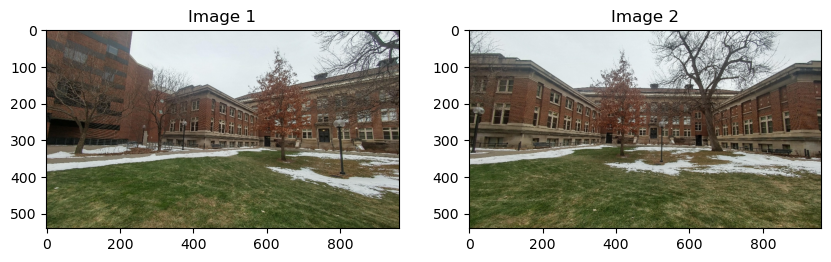

In [25]:
image1_rgb = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)
image2_rgb = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)
image3_rgb = cv2.cvtColor(image3, cv2.COLOR_BGR2RGB)
image4_rgb = cv2.cvtColor(image4, cv2.COLOR_BGR2RGB)
image5_rgb = cv2.cvtColor(image5, cv2.COLOR_BGR2RGB)
image6_rgb = cv2.cvtColor(image6, cv2.COLOR_BGR2RGB)
image7_rgb = cv2.cvtColor(image7, cv2.COLOR_BGR2RGB)
image8_rgb = cv2.cvtColor(image8, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(image1_rgb)
plt.title('Image 1')

plt.subplot(1, 2, 2)
plt.imshow(image2_rgb)
plt.title('Image 2')

plt.show()

# Question 2.1

In [26]:
''' we initialise the SIFT detector'''
sift = cv2.SIFT_create(nOctaveLayers=10, contrastThreshold=0.05, edgeThreshold=10, sigma=1.6)
# high contrastThreshold means the blurs which are not clear will be removed
# edgeThreshold removes keypoints at the edge of the image

'''keypoint detection and descriptor computation stage '''
keypoints1, descriptors1 = sift.detectAndCompute(image1, None)
keypoints2, descriptors2 = sift.detectAndCompute(image2, None)
keypoints3, descriptors3 = sift.detectAndCompute(image3, None)
keypoints4, descriptors4 = sift.detectAndCompute(image4, None)
keypoints5, descriptors5 = sift.detectAndCompute(image5, None)
keypoints6, descriptors6 = sift.detectAndCompute(image6, None)
keypoints7, descriptors7 = sift.detectAndCompute(image7, None)
keypoints8, descriptors8 = sift.detectAndCompute(image8, None)

''' draw keypoints on images '''
image1_with_keypoints = cv2.drawKeypoints(image1_rgb, keypoints1, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
image2_with_keypoints = cv2.drawKeypoints(image2_rgb, keypoints2, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
image3_with_keypoints = cv2.drawKeypoints(image2_rgb, keypoints3, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
image4_with_keypoints = cv2.drawKeypoints(image2_rgb, keypoints4, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
image5_with_keypoints = cv2.drawKeypoints(image2_rgb, keypoints5, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
image6_with_keypoints = cv2.drawKeypoints(image2_rgb, keypoints6, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
image7_with_keypoints = cv2.drawKeypoints(image2_rgb, keypoints7, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
image8_with_keypoints = cv2.drawKeypoints(image2_rgb, keypoints8, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

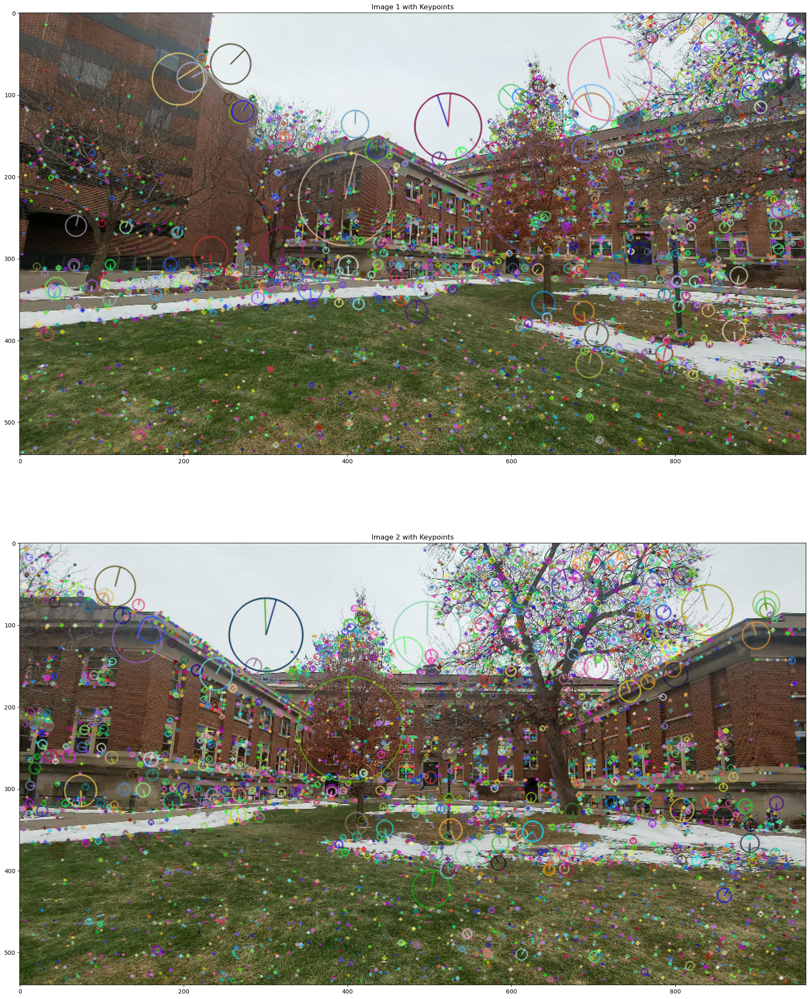

In [27]:
''' Display images with keypoints '''
plt.figure(figsize=(30, 30))  # Adjust the figure size as needed
plt.subplot(2, 1, 1)  # Display images vertically, one above the other
plt.imshow(image1_with_keypoints)
plt.title('Image 1 with Keypoints')

plt.subplot(2, 1, 2)
plt.imshow(image2_with_keypoints)
plt.title('Image 2 with Keypoints')

plt.show()

# Question 2.2

In [28]:
# Initialization
bf = cv2.BFMatcher()
flann = cv2.FlannBasedMatcher()

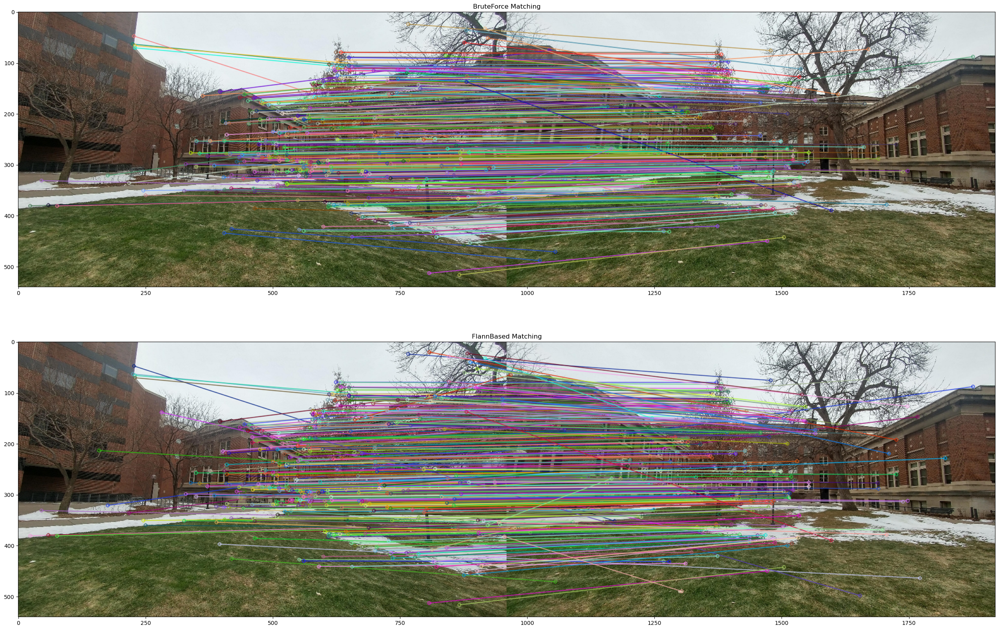

In [29]:
'''perform BruteForce matching'''
matches_bf = bf.knnMatch(descriptors1, descriptors2, k=2)

'''apply ratio test to select good matches'''
good_matches_bf = []
for m, n in matches_bf:
    if m.distance < 0.75 * n.distance:
        good_matches_bf.append(m)

'''Draw matches'''
image_matches_bf = cv2.drawMatches(image1_rgb, keypoints1, image2_rgb, keypoints2, good_matches_bf, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

''' Perform FLANN-based matching '''
matches_flann = flann.knnMatch(descriptors1, descriptors2, k=2)

''' Apply ratio test to select good matches '''
good_matches_flann = []
for m, n in matches_flann:
    if m.distance < 0.75 * n.distance:
        good_matches_flann.append(m)

''' Draw matches '''
image_matches_flann = cv2.drawMatches(image1_rgb, keypoints1, image2_rgb, keypoints2, good_matches_flann, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

''' Display matched features '''
plt.figure(figsize=(50, 20))

plt.subplot(2, 1, 1)
plt.imshow(image_matches_bf)
plt.title('BruteForce Matching')

plt.subplot(2, 1, 2)
plt.imshow(image_matches_flann)
plt.title('FlannBased Matching')

plt.show()

good_matches = good_matches_flann

# Question 2.3

In [30]:
import numpy as np
import cv2

def compute_homography(keypoints1, descriptors1, keypoints2, descriptors2, good_matches):
    """
    computing the homography matrix using RANSAC.

    arguments:
    - keypoints1: Keypoints from the first image.
    - descriptors1: Descriptors from the first image.
    - keypoints2: Keypoints from the second image.
    - descriptors2: Descriptors from the second image.
    - good_matches: List of good matches between the keypoints.

    it will return:
    - homography: The computed homography matrix.
    """

    ''' converted keypoints to numpy arrays '''
    pts1 = np.float32([keypoints1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    pts2 = np.float32([keypoints2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

    ''' computed homography matrix using RANSAC '''
    homography, _ = cv2.findHomography(pts2, pts1, cv2.RANSAC)

    return homography

homography = compute_homography(keypoints1, descriptors1, keypoints2, descriptors2, good_matches)
print("Homography Matrix:")
print(homography)

Homography Matrix:
[[-6.34696002e-03  6.10923194e-03  3.61685289e+02]
 [-3.04760699e-01  5.85500973e-01  1.25034627e+02]
 [-1.01503633e-03 -5.16598861e-05  1.00000000e+00]]


# Question 2.4

In [31]:
def perspective_warp_and_return(image1_rgb, image2_rgb, homography):
    """
    performed perspective warping to align image2 with image1 using the given homography matrix,
    and return the resulting panorama.

    Args:
    - image1_rgb: First input image (reference image).
    - image2_rgb: Second input image to be aligned with the first image.
    - homography: Homography matrix computed for aligning image2 with image1.

    Returns:
    - panorama: The resulting panorama image.
    """
    image2_aligned = cv2.warpPerspective(image2_rgb, homography, (image1_rgb.shape[1], image1_rgb.shape[0]))
    panorama = np.zeros((max(image1_rgb.shape[0], image2_aligned.shape[0]), 
                         image1_rgb.shape[1] + image2_aligned.shape[1], 3), dtype=np.uint8)

    panorama[:image1_rgb.shape[0], :image1_rgb.shape[1]] = image1_rgb
    panorama[:image2_aligned.shape[0], image1_rgb.shape[1]:] = image2_aligned

    return panorama

panorama = perspective_warp_and_return(image1_rgb, image2_rgb, homography)

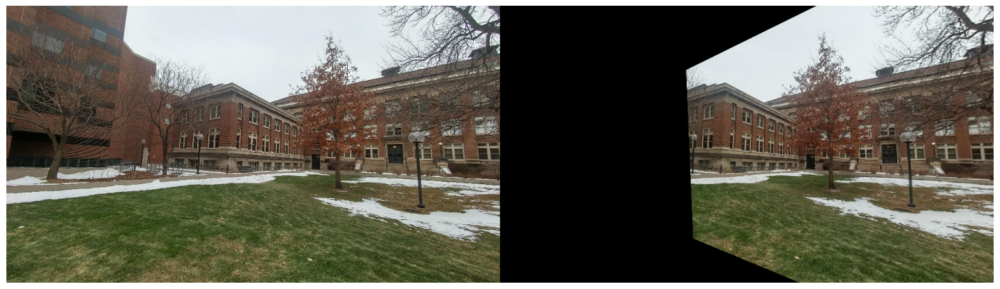

In [32]:
plt.figure(figsize=(20,10))
plt.axis('off')
plt.imshow(panorama)

# Question 2.5

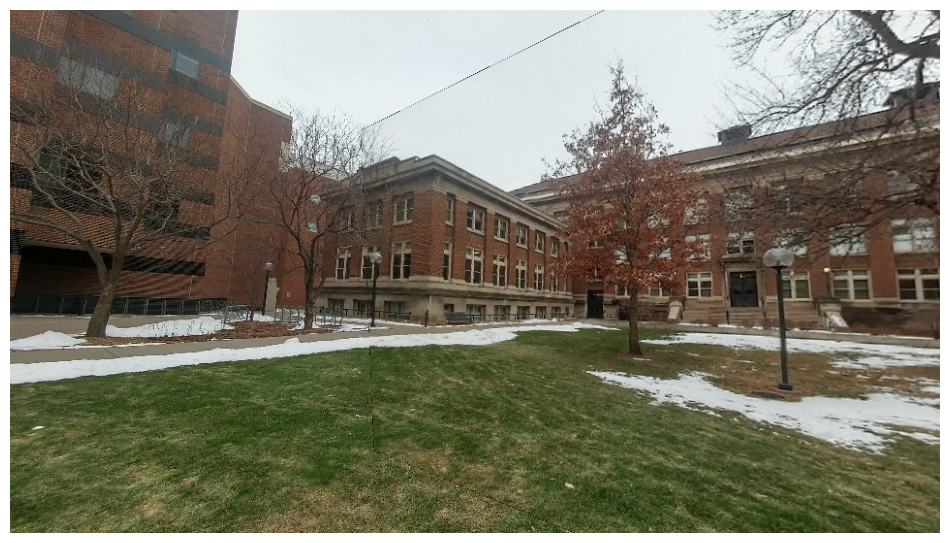

In [38]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def stitch_images(image1, image2, homography):
    image2_aligned = cv2.warpPerspective(image2, homography, (image1.shape[1], image1.shape[0]))

    mask2 = np.ones_like(image2_aligned, dtype=np.float32)

    stitched_img = image1.copy()
    stitched_img = np.where(image2_aligned != 0, image2_aligned, stitched_img)

    return stitched_img

stitched_img = stitch_images(image1, image2, homography)

plt.figure(figsize=(12, 8))  # Adjust figure size here
plt.imshow(cv2.cvtColor(stitched_img, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

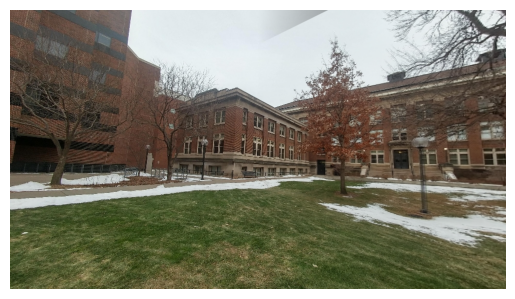

In [34]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def gradient_blend(image1, image2):
    mask = np.zeros_like(image1, dtype=np.float32)
    mask[:, :int(image1.shape[1] / 2), :] = 1.0
    mask[:, int(image1.shape[1] / 2):, :] = np.linspace(1.0, 0.0, int(image1.shape[1] / 2))[:, np.newaxis]

    blended_image = np.copy(image1)
    blended_image[:, :] = image1[:, :] * mask[:, :] + \
                          image2[:, :] * (1 - mask[:, :])

    return blended_image

def blend_images(image1, image2, homography):
    image2_aligned = cv2.warpPerspective(image2, homography, (image1.shape[1], image1.shape[0]))

    blended_img = gradient_blend(image1, image2_aligned)

    return blended_img

blended_img = blend_images(image1, image2, homography)

plt.imshow(cv2.cvtColor(blended_img, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

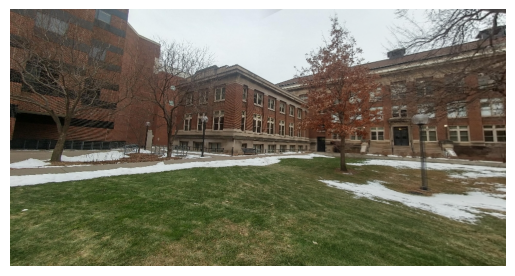

In [36]:
import cv2

def crop_top_percentage(image, percentage):
    """
    crop the specified percentage of the image height from the top.

    args:
    - image: Input image to be cropped.
    - percentage: Percentage of the image height to be cropped from the top.

    returns:
    - cropped_image: Cropped image with the specified percentage of the image height removed from the top.
    """
    height, width = image.shape[:2]
    crop_height = int(height * percentage)

    cropped_image = image[crop_height:, :]

    return cropped_image

percentage = 0.08

# Crop the image
cropped_img = crop_top_percentage(blended_img, percentage)

# Display the cropped image
plt.imshow(cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()